# Getting started with NeuroLogic programming

The following example aims to familiarize the reader with the proposed formalism and briefly illustrate its benefits. The goal for the learned model is to  predict (compute) score of words in Scrabble\footnote{Further, bonus points are added for selected bi-grams to demonstrate the use of rules with more than one literal in the body.}.

The model is described as a weighted logic program, further referred to as a template.
The template reflects the high-level structure of the resulting models and possibly some background knowledge about the problem. In Srabble for instance, we know that every letter affects the score of a word. To make the situation more interesting, we will consider that the same holds for bi-grams of letters. To encode the knowledge, we use Horn clauses (also called rules).

Each rule is in the following format: 
$$
\underbrace{\texttt{0.0}}_{\text{weight}}\texttt{ }\underbrace{\texttt{score()}}_{\text{rule head}} \texttt{ :- }\underbrace{\texttt{letterA(X)}}_{\text{rule tail}}. \underbrace{\texttt{[lukasiewicz]}}_{\text{activation function (optional)}}
$$
Weight of the rule is either learnable (then the weight represents the initial value for learning with the exception of $0.0$, where the initial weight value will be randomly generated) or fixed (fixed weights are enclosed in angle brackets).
In our sample scenario, we do not know the weight of any letter, and so every rule in this example will have learnable weight. The template for this problem will look as follows\footnote{for the whole template see \fullref{scrabble---template} }.

### Template

In [1]:
%%writefile scrabble_rules.pl
0.0 score() :- letter(Letter,Position),
               member(Letter,[a,b,c,d,e,f,g,h,i,j,k,l,m,n,o,p,q,r,s,t,u,v,w,x,y,z]). [^Letter,identity]
score/0 [identity]

Overwriting scrabble_rules.pl


The training set consists of grounded rules. These rules act as examples to learn the right weights in the lifted (templated) model. Every example should be provable from the (learned) model. In this particular example, we know only scores for some words, the corresponding rules will be in the following format.
  $$
     \underbrace{\texttt{7.0}}_{\text{desired output}}\texttt{ }\underbrace{\texttt{score()}}_{\text{query}} \texttt{ :- }\underbrace{\texttt{letterH(l1),letterI(l2),next(l1,l2)}}_{\text{evidence}}.
  $$

### Training set

In [2]:
%%writefile scrabble_training_set.pl
19 score() :- letter(m,1),letter(a,2),letter(l,3),letter(e,4),letter(d,5),letter(i,6),letter(c,7),letter(t,8),letter(o,9),letter(r,10),letter(y,11).
9  score() :- letter(t,1),letter(a,2),letter(n,3),letter(g,4),letter(i,5),letter(n,6),letter(g,7).
19 score() :- letter(v,1),letter(a,2),letter(g,3),letter(a,4),letter(b,5),letter(o,6),letter(n,7),letter(d,8),letter(a,9),letter(g,10),letter(e,11).
23 score() :- letter(b,1),letter(e,2),letter(j,3),letter(u,4),letter(m,5),letter(b,6),letter(l,7),letter(e,8),letter(d,9).
17 score() :- letter(p,1),letter(a,2),letter(d,3),letter(d,4),letter(l,5),letter(e,6),letter(b,7),letter(a,8),letter(l,9),letter(l,10),letter(s,11).
13 score() :- letter(b,1),letter(i,2),letter(o,3),letter(a,4),letter(s,5),letter(s,6),letter(a,7),letter(y,8).
21 score() :- letter(f,1),letter(i,2),letter(a,3),letter(n,4),letter(c,5),letter(h,6),letter(e,7),letter(t,8),letter(t,9),letter(o,10),letter(e,11),letter(d,12).
16 score() :- letter(s,1),letter(u,2),letter(c,3),letter(c,4),letter(o,5),letter(t,6),letter(a,7),letter(s,8),letter(h,9).
18 score() :- letter(u,1),letter(n,2),letter(p,3),letter(i,4),letter(c,5),letter(k,6),letter(i,7),letter(n,8),letter(g,9).
20 score() :- letter(b,1),letter(i,2),letter(l,3),letter(d,4),letter(u,5),letter(n,6),letter(g,7),letter(s,8),letter(r,9),letter(o,10),letter(m,11),letter(a,12),letter(n,13),letter(e,14).
24 score() :- letter(d,1),letter(e,2),letter(h,3),letter(y,4),letter(d,5),letter(r,6),letter(o,7),letter(g,8),letter(e,9),letter(n,10),letter(a,11),letter(t,12),letter(i,13),letter(o,14),letter(n,15).
16 score() :- letter(d,1),letter(o,2),letter(w,3),letter(n,4),letter(f,5),letter(a,6),letter(l,7),letter(l,8),letter(s,9).
11 score() :- letter(m,1),letter(o,2),letter(p,3),letter(e,4),letter(d,5),letter(s,6).
21 score() :- letter(e,1),letter(v,2),letter(o,3),letter(c,4),letter(a,5),letter(t,6),letter(i,7),letter(v,8),letter(e,9),letter(n,10),letter(e,11),letter(s,12),letter(s,13).
22 score() :- letter(c,1),letter(h,2),letter(a,3),letter(f,4),letter(f,5),letter(e,6),letter(r,7),letter(i,8),letter(n,9),letter(g,10).
27 score() :- letter(f,1),letter(l,2),letter(i,3),letter(b,4),letter(b,5),letter(e,6),letter(r,7),letter(t,8),letter(i,9),letter(g,10),letter(i,11),letter(b,12),letter(b,13),letter(e,14),letter(t,15).
16 score() :- letter(a,1),letter(f,2),letter(t,3),letter(e,4),letter(r,5),letter(w,6),letter(a,7),letter(r,8),letter(d,9).
22 score() :- letter(i,1),letter(n,2),letter(f,3),letter(l,4),letter(a,5),letter(m,6),letter(m,7),letter(a,8),letter(t,9),letter(o,10),letter(r,11),letter(y,12).
17 score() :- letter(o,1),letter(l,2),letter(i,3),letter(g,4),letter(a,5),letter(r,6),letter(c,7),letter(h,8),letter(i,9),letter(e,10),letter(s,11).
12 score() :- letter(n,1),letter(i,2),letter(t,3),letter(r,4),letter(o,5),letter(g,6),letter(e,7),letter(n,8),letter(a,9),letter(s,10),letter(e,11).
18 score() :- letter(s,1),letter(o,2),letter(m,3),letter(a,4),letter(t,5),letter(o,6),letter(l,7),letter(o,8),letter(g,9),letter(i,10),letter(c,11),letter(a,12),letter(l,13).
15 score() :- letter(h,1),letter(i,2),letter(g,3),letter(h,4),letter(t,5),letter(a,6),letter(i,7),letter(l,8).
18 score() :- letter(c,1),letter(h,2),letter(i,3),letter(m,4),letter(a,5),letter(e,6),letter(r,7),letter(i,8),letter(c,9).
15 score() :- letter(c,1),letter(h,2),letter(o,3),letter(p,4),letter(i,5),letter(n,6),letter(e,7),letter(s,8).
14 score() :- letter(m,1),letter(e,2),letter(d,3),letter(i,4),letter(c,5),letter(a,6),letter(i,7),letter(d,8).
14 score() :- letter(m,1),letter(o,2),letter(l,3),letter(e,4),letter(s,5),letter(k,6),letter(i,7),letter(n,8).
15 score() :- letter(m,1),letter(u,2),letter(l,3),letter(t,4),letter(i,5),letter(e,6),letter(n,7),letter(g,8),letter(i,9),letter(n,10),letter(e,11),letter(s,12).
19 score() :- letter(j,1),letter(e,2),letter(r,3),letter(e,4),letter(m,5),letter(i,6),letter(a,7),letter(d,8),letter(s,9).
20 score() :- letter(r,1),letter(e,2),letter(e,3),letter(j,4),letter(e,5),letter(c,6),letter(t,7),letter(i,8),letter(n,9),letter(g,10).
29 score() :- letter(s,1),letter(t,2),letter(o,3),letter(c,4),letter(k,5),letter(j,6),letter(o,7),letter(b,8),letter(b,9),letter(e,10),letter(r,11),letter(s,12).
15 score() :- letter(p,1),letter(i,2),letter(k,3),letter(e,4),letter(m,5),letter(a,6),letter(n,7).
15 score() :- letter(d,1),letter(i,2),letter(b,3),letter(b,4),letter(u,5),letter(k,6).
17 score() :- letter(b,1),letter(l,2),letter(o,3),letter(c,4),letter(k,5),letter(i,6),letter(e,7),letter(s,8),letter(t,9).
10 score() :- letter(s,1),letter(w,2),letter(o,3),letter(l,4),letter(l,5),letter(e,6),letter(n,7).
13 score() :- letter(s,1),letter(y,2),letter(l,3),letter(p,4),letter(h,5).
14 score() :- letter(s,1),letter(a,2),letter(g,3),letter(i,4),letter(t,5),letter(t,6),letter(a,7),letter(l,8),letter(l,9),letter(y,10).
5  score() :- letter(m,1),letter(o,2),letter(n,3).
12 score() :- letter(m,1),letter(a,2),letter(s,3),letter(h,4),letter(e,5),letter(d,6).
29 score() :- letter(c,1),letter(y,2),letter(t,3),letter(o,4),letter(p,5),letter(h,6),letter(o,7),letter(t,8),letter(o,9),letter(m,10),letter(e,11),letter(t,12),letter(r,13),letter(i,14),letter(c,15).
14 score() :- letter(b,1),letter(o,2),letter(n,3),letter(e,4),letter(y,5),letter(a,6),letter(r,7),letter(d,8).
17 score() :- letter(h,1),letter(a,2),letter(n,3),letter(d,4),letter(y,5),letter(m,6),letter(a,7),letter(n,8).
15 score() :- letter(t,1),letter(e,2),letter(c,3),letter(h,4),letter(n,5),letter(i,6),letter(c,7),letter(s,8).
28 score() :- letter(m,1),letter(a,2),letter(g,3),letter(n,4),letter(i,5),letter(l,6),letter(o,7),letter(q,8),letter(u,9),letter(e,10),letter(n,11),letter(c,12),letter(e,13),letter(s,14).
14 score() :- letter(e,1),letter(r,2),letter(g,3),letter(o,4),letter(t,5),letter(a,6),letter(m,7),letter(i,8),letter(n,9),letter(e,10),letter(s,11).
9  score() :- letter(o,1),letter(r,2),letter(g,3),letter(a,4),letter(s,5),letter(m,6).
24 score() :- letter(t,1),letter(r,2),letter(a,3),letter(n,4),letter(s,5),letter(p,6),letter(l,7),letter(a,8),letter(n,9),letter(t,10),letter(a,11),letter(b,12),letter(i,13),letter(l,14),letter(i,15),letter(t,16),letter(y,17).
12 score() :- letter(m,1),letter(o,2),letter(p,3),letter(e,4),letter(r,5),letter(i,6),letter(e,7),letter(s,8).
22 score() :- letter(i,1),letter(c,2),letter(o,3),letter(n,4),letter(o,5),letter(g,6),letter(r,7),letter(a,8),letter(p,9),letter(h,10),letter(i,11),letter(c,12).
23 score() :- letter(s,1),letter(q,2),letter(u,3),letter(e,4),letter(a,5),letter(k,6),letter(y,7).
18 score() :- letter(m,1),letter(a,2),letter(r,3),letter(q,4),letter(u,5),letter(e,6),letter(s,7).
27 score() :- letter(q,1),letter(u,2),letter(i,3),letter(c,4),letter(k,5),letter(s,6),letter(t,7),letter(e,8),letter(p,9),letter(s,10).
17 score() :- letter(c,1),letter(l,2),letter(o,3),letter(b,4),letter(b,5),letter(e,6),letter(r,7),letter(i,8),letter(n,9),letter(g,10).
17 score() :- letter(u,1),letter(n,2),letter(d,3),letter(e,4),letter(r,5),letter(c,6),letter(o,7),letter(a,8),letter(t,9),letter(i,10),letter(n,11),letter(g,12),letter(s,13).
12 score() :- letter(w,1),letter(r,2),letter(o,3),letter(n,4),letter(g,5),letter(e,6),letter(d,7).
16 score() :- letter(n,1),letter(o,2),letter(n,3),letter(r,4),letter(e,5),letter(s,6),letter(p,7),letter(o,8),letter(n,9),letter(d,10),letter(e,11),letter(n,12),letter(t,13).
12 score() :- letter(b,1),letter(e,2),letter(a,3),letter(s,4),letter(t,5),letter(i,6),letter(n,7),letter(g,8),letter(s,9).
24 score() :- letter(s,1),letter(q,2),letter(u,3),letter(e,4),letter(l,5),letter(c,6),letter(h,7),letter(e,8),letter(d,9).
18 score() :- letter(p,1),letter(u,2),letter(l,3),letter(s,4),letter(o,5),letter(j,6),letter(e,7),letter(t,8),letter(s,9).
13 score() :- letter(o,1),letter(u,2),letter(t,3),letter(f,4),letter(l,5),letter(e,6),letter(w,7).
8  score() :- letter(p,1),letter(l,2),letter(a,3),letter(n,4),letter(e,5),letter(t,6).
18 score() :- letter(s,1),letter(o,2),letter(u,3),letter(t,4),letter(h,5),letter(w,6),letter(e,7),letter(s,8),letter(t,9),letter(e,10),letter(r,11),letter(n,12).
16 score() :- letter(h,1),letter(e,2),letter(a,3),letter(d,4),letter(h,5),letter(u,6),letter(n,7),letter(t,8),letter(s,9).
32 score() :- letter(m,1),letter(e,2),letter(s,3),letter(e,4),letter(m,5),letter(b,6),letter(r,7),letter(y,8),letter(a,9),letter(n,10),letter(t,11),letter(h,12),letter(e,13),letter(m,14),letter(u,15),letter(m,16).
20 score() :- letter(i,1),letter(n,2),letter(t,3),letter(e,4),letter(r,5),letter(v,6),letter(a,7),letter(l,8),letter(o,9),letter(m,10),letter(e,11),letter(t,12),letter(e,13),letter(r,14),letter(s,15).
12 score() :- letter(g,1),letter(r,2),letter(e,3),letter(a,4),letter(v,5),letter(e,6),letter(d,7).
20 score() :- letter(f,1),letter(a,2),letter(c,3),letter(i,4),letter(l,5),letter(i,6),letter(t,7),letter(a,8),letter(t,9),letter(i,10),letter(v,11),letter(e,12).
14 score() :- letter(p,1),letter(r,2),letter(e,3),letter(d,4),letter(a,5),letter(w,6),letter(n,7),letter(s,8).
13 score() :- letter(w,1),letter(e,2),letter(l,3),letter(f,4),letter(a,5),letter(r,6),letter(e,7).
8  score() :- letter(s,1),letter(w,2),letter(a,3),letter(g,4).
21 score() :- letter(b,1),letter(a,2),letter(n,3),letter(d,4),letter(b,5),letter(o,6),letter(x,7),letter(e,8),letter(s,9).
23 score() :- letter(p,1),letter(e,2),letter(m,3),letter(p,4),letter(h,5),letter(i,6),letter(x,7).
14 score() :- letter(r,1),letter(e,2),letter(l,3),letter(a,4),letter(x,5),letter(i,6),letter(n,7).
28 score() :- letter(k,1),letter(y,2),letter(m,3),letter(o,4),letter(g,5),letter(r,6),letter(a,7),letter(p,8),letter(h,9),letter(i,10),letter(c,11).
30 score() :- letter(h,1),letter(y,2),letter(p,3),letter(e,4),letter(r,5),letter(e,6),letter(x,7),letter(t,8),letter(e,9),letter(n,10),letter(d,11),letter(e,12),letter(d,13).
24 score() :- letter(c,1),letter(l,2),letter(i,3),letter(t,4),letter(o,5),letter(r,6),letter(i,7),letter(d,8),letter(e,9),letter(c,10),letter(t,11),letter(o,12),letter(m,13),letter(y,14).
16 score() :- letter(d,1),letter(i,2),letter(t,3),letter(z,4),letter(e,5),letter(s,6).
21 score() :- letter(t,1),letter(e,2),letter(n,3),letter(d,4),letter(e,5),letter(r,6),letter(i,7),letter(z,8),letter(e,9),letter(d,10).
26 score() :- letter(p,1),letter(a,2),letter(r,3),letter(a,4),letter(m,5),letter(e,6),letter(t,7),letter(e,8),letter(r,9),letter(i,10),letter(z,11),letter(e,12),letter(s,13).

Overwriting scrabble_training_set.pl


# Setup & Start Learning phase (may take a while to finish)


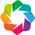

In [1]:
from neurologic import run, plot_statistics, learned_template
import holoviews as hv
from IPython.display import IFrame
from IPython.display import display_svg
hv.notebook_extension('bokeh')

In [2]:
output = run("scrabble_rules.pl","scrabble_training_set.pl",grounding="sum")

java -jar '/Users/janstudeny/Library/Mobile Documents/com~apple~CloudDocs/Active projects/NeuroLogic frontend/neurologic/neurologic.jar' --grounding=sum --examples=./.examples_raw.pl --rules=./.rules_raw.pl


# Results: Learning curve

In [3]:
%%opts Curve [width=625 height=400]
plot_statistics(output)

:DynamicMap   [fold,restart,error type]

# Results: Learned template

In [4]:
print(learned_template(output))

9.999999999999990 score(a) :- letter(z,Position).
4.000000000000001 score(a) :- letter(y,Position).
7.999999999999997 score(a) :- letter(x,Position).
3.999999999999999 score(a) :- letter(w,Position).
3.999999999999997 score(a) :- letter(v,Position).
1.000000000000003 score(a) :- letter(u,Position).
0.999999999999999 score(a) :- letter(t,Position).
1.000000000000000 score(a) :- letter(s,Position).
1.000000000000000 score(a) :- letter(r,Position).
9.999999999999990 score(a) :- letter(q,Position).
3.000000000000001 score(a) :- letter(p,Position).
0.999999999999999 score(a) :- letter(o,Position).
0.999999999999999 score(a) :- letter(n,Position).
2.999999999999999 score(a) :- letter(m,Position).
1.000000000000000 score(a) :- letter(l,Position).
5.000000000000001 score(a) :- letter(k,Position).
7.999999999999998 score(a) :- letter(j,Position).
1.000000000000001 score(a) :- letter(i,Position).
3.999999999999998 score(a) :- letter(h,Position).
2.000000000000000 score(a) :- letter(g,Position).


# Results: Neural networks

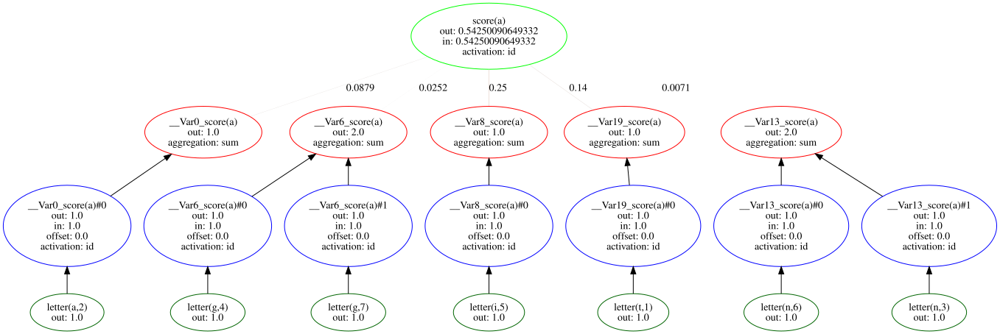

In [17]:
%%opts RGB [width=950 height=500]
display_neural_nets(output)

:DynamicMap   [Example]

In [ ]:
%store output

In [7]:
from neurologic import run, plot_statistics, learned_template, display_neural_nets
import os
import subprocess
%load_ext autoreload
%autoreload 2
%store -r output

In [ ]:
image_file = './outputs/./images/network α #0 post learning.png'
dot_file = './outputs/./images/network  #0 post learning.png'

In [ ]:
proc = subprocess.run(["dot", "-Tpng", dot_file, "-o", image_file])

In [9]:
rgb

:RGB   [x,y]   (R,G,B,A)

In [27]:
%%HTML
<html>
<body>
<h1>Demo for svg-pan-zoom: SVG in HTML 'object' element</h1>
<object id="demo-tiger" type="image/svg+xml" data="https://cdn.rawgit.com/ariutta/svg-pan-zoom/master/demo/tiger.svg" style="width: 500px; height: 500px; border:1px solid black; ">Your browser does not support SVG</object>
<script>
require.config({
  paths: {
      panzoom: '//cdn.rawgit.com/ariutta/svg-pan-zoom/master/dist/svg-pan-zoom'
  }
});
require(['panzoom'], function(panzoom) {
    console.log("Loaded :)"); 

    var s = document.getElementById('demo-tiger')
    s.onload = function(panzoom){
        console.log('loaded')

        panzoom.svgPanZoom('#demo-tiger', {
          zoomEnabled: true,
          controlIconsEnabled: true
        });
        }

    });
</script>
</body>
</html>

In [1]:
from ipywidgets import interact
interact(lambda x: display_neural_nets(output)[x],x=1)

NameError: name 'display_neural_nets' is not defined

<function __main__.<lambda>>

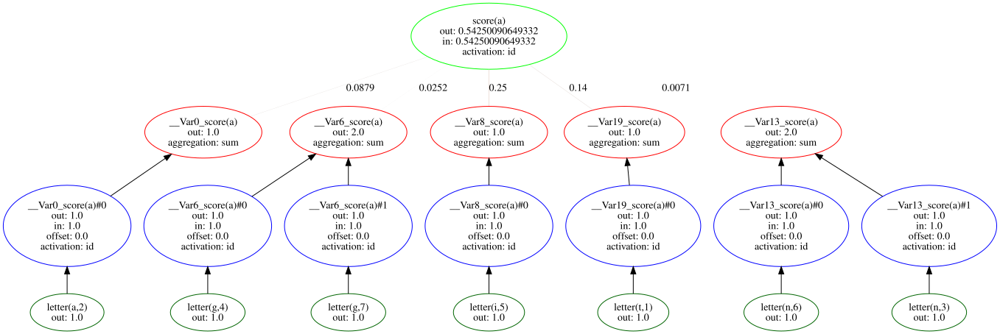

AttributeError: 'NoneType' object has no attribute 'id'

:DynamicMap   [a]

In [6]:
hv.DynamicMap(lambda x:display_svg(open("outputs/images/example.svg").read(),raw=True),kdims=[hv.Dimension('a',values=[1,2,3])])